In [1]:
import streamlit as st
import pandas as pd
import numpy as np
import gensim
from gensim.models import Word2Vec
from gensim.models import FastText
from sklearn.decomposition import PCA
from matplotlib import pyplot
from IPython.core.interactiveshell import InteractiveShell
InteractiveShell.ast_node_interactivity='all'

In [2]:
import matplotlib.pyplot as plt # our main display package
import plotly.graph_objects as go
import string # used for preprocessing
import re # used for preprocessing
import nltk # the Natural Language Toolkit, used for preprocessing
import numpy as np # used for managing NaNs
import nltk
from nltk.tokenize import word_tokenize
from nltk.corpus import stopwords # used for preprocessing
from nltk.stem import WordNetLemmatizer # used for preprocessing
from sklearn.model_selection import train_test_split
nltk.download('stopwords')
nltk.download('wordnet')
nltk.download('punkt')

[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\Gyegn\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


True

[nltk_data] Downloading package wordnet to
[nltk_data]     C:\Users\Gyegn\AppData\Roaming\nltk_data...
[nltk_data]   Package wordnet is already up-to-date!


True

[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\Gyegn\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!


True

In [7]:
# Import dataset
df = pd.read_csv(r"dimensions-covid19-export-2021-09-01-h15-01-02_clinical_trials.csv")

UnicodeDecodeError: 'utf-8' codec can't decode byte 0xb2 in position 209254: invalid start byte

In [9]:
with open("dimensions-covid19-export-2021-09-01-h15-01-02_clinical_trials.csv","r",encoding="utf-8",errors="ignore") as f:
    content = f.read()

In [9]:
print(content)

Date added,Trial ID,Title,Brief title,Acronym,Abstract,Publication date,Active years,Phase,Conditions,Intervention,Gender,Registry,Investigators/Contacts,Sponsors/Collaborators,GRID IDs,Country of Sponsor/Collaborator,Collaborating Funders,Funder Country,Source Linkout,Dimensions URL,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
9/1/2021,NCT05029245,"The 8-week, Prospective, Randomized Controlled of IntraDermal Administration of Comirnaty® 6 Microgram Versus Intramuscular Comirnaty® 30 Microgram by 28 Days Interval Efficacy Study in Healthy Volunteer",IntraDermal Versus Intramuscular Comirnaty® Efficacy Study,PRIDE,"The 8-week, Prospective, Randomized controlled of IntraDermal administration of Comirnaty® 6 microgram compare to Intramuscular Comirnaty® 30 microgram by 28 days interval Efficacy Study in 4 groups of healthy volunteer ( 1 people who complete sinovac vaccination 2 people who received 1 dosage of 

In [12]:
from io import StringIO

In [13]:
df = pd.read_csv(StringIO(content))

C:\Users\Gyegn\AppData\Local\Temp\ipykernel_22004\3944606450.py:1: DtypeWarning: Columns (21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,133,134,135,136,137,138,139,140,143,144) have mixed types. Specify dtype option on import or set low_memory=False.
  df = pd.read_csv(StringIO(content))


In [14]:
df.head()
df.shape

,Date added,Trial ID,Title,Brief title,Acronym,Abstract,Publication date,Active years,Phase,Conditions,...,Unnamed: 135,Unnamed: 136,Unnamed: 137,Unnamed: 138,Unnamed: 139,Unnamed: 140,Unnamed: 141,Unnamed: 142,Unnamed: 143,Unnamed: 144
0,9/1/2021,NCT05029245,"The 8-week, Prospective, Randomized Controlled...",IntraDermal Versus Intramuscular Comirnaty® Ef...,PRIDE,"The 8-week, Prospective, Randomized controlled...",8/31/2021,2021; 2022,Phase 3,Covid19 Vaccine; Covid19,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,9/1/2021,NCT05029037,High-dose Intravenous Vitamin C (HDIVC) as Adj...,High-dose Intravenous Vitamin C (HDIVC) as Adj...,HDIVC,The objective of this study is to evaluate the...,9/15/2021,2021; 2022,Phase 3,Covid19,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,9/1/2021,NCT05029011,Low-cost Sensor System for COVID-19 Patient Mo...,Low-cost Sensor System for COVID-19 Patient Mo...,NaN,"The MediByte VTS is a low-cost, portable devic...",9/1/2021,2021; 2022,NaN,The Focus is How Well the MediByte VTS Will Mo...,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,9/1/2021,NCT05028998,The Impact of COVID-19-related Medication Assi...,Covid-related Opioid Treatment Policy Evaluation,COPE,Our nation is facing the COVID-19 pandemic dur...,9/1/2021,2021; 2022; 2023,NaN,Opioid-use Disorder; Alcohol Use Disorder,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,9/1/2021,NCT05028881,Serological Responses to SARS-CoV-2 and Their ...,Hong Kong HIV SARS-CoV-2 Serology,NaN,Immunodeficiency associated with human immunod...,5/16/2020,2020; 2021; 2022; 2023,NaN,HIV Infections; SARS-CoV-2 Infection; Vaccinat...,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


(12126, 145)

In [15]:
df['Abstract'][0]

'The 8-week, Prospective, Randomized controlled of IntraDermal administration of Comirnaty® 6 microgram compare to Intramuscular Comirnaty® 30 microgram by 28 days interval Efficacy Study in 4 groups of healthy volunteer ( 1 people who complete sinovac vaccination 2 people who received 1 dosage of AstraZeneca vaccine 3 naive vaccination 4 any other vaccination not in 1-3 with anti Spike antibody less than 650 AU/ ml) . Comparison of antibody level and T cell response to SAR-CoV-2 antigen in vitro after 28 day post vaccination is primary outcome and the side effect as well as infection rate in 8 weeks is secondary outcomes.\n\nDetailed Description\nThe 8-week, Prospective, Randomized controlled of IntraDermal administration of Comirnaty® 6 microgram compare to Intramuscular Comirnaty® 30 microgram by 28 days interval Efficacy Study in healthy volunteer.To compare the AntiSpike antibody, ( Anti RBD ) neutralized antibody ( if possible) of SAR-CoV-2 and T-cell response after injection wit

In [17]:
# Text Preprocessing
# function to remove all urls 
def remove_urls(text):
    new_text = ' '.join(re.sub("(@[A-Za-z0-9]+)|([^A-Z0-9a-z \t])|(\w+:\/\/\S+)"," ",text).split())
    return new_text

# make text lower case
def lower_case(text):
    text = text.lower()
    return text

# remove numbers
def remove_numbers(text):
    result = re.sub(r'\d+','',text)
    return result

# remove punctuation
def remove_punctuation(text):
    translator = str.maketrans('','',string.punctuation)
    text = text.translate(translator)
    return text

# tokenize
def tokenize(text):
    text = word_tokenize(text)
    return text

# remove stopwords
def remove_stopwords(text):
    stop_words = set(stopwords.words('english'))
    text = [i for i in text if i not in stop_words]
    return text

# lemmatize text
lemmatizer = WordNetLemmatizer()
def lemmatize(text):
    text = [lemmatizer.lemmatize(token) for token in text]
    return text

# preprocessing the text
def preprocessing(text):

    text = lower_case(text)
    text = remove_urls(text)
    text = remove_numbers(text)
    text = remove_punctuation(text)
    text = tokenize(text)
    text = remove_stopwords(text)
    text = lemmatize(text)
    text = ' '.join(text)
    
    return text

In [21]:
# Applying the preprocessing over text
for i in range(df['Abstract'].shape[0]):
    df['Abstract'][i] = preprocessing(str(df['Abstract'][i]))

for text in df.Abstract:
    text = text.replace('\n',' ')

C:\Users\Gyegn\AppData\Local\Temp\ipykernel_22004\2533231897.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Abstract'][i] = preprocessing(str(df['Abstract'][i]))


In [23]:
df.Abstract[0]

'week prospective randomized controlled intradermal administration comirnaty microgram compare intramuscular comirnaty microgram day interval efficacy study group healthy volunteer people complete sinovac vaccination people received dosage astrazeneca vaccine naive vaccination vaccination anti spike antibody le au ml comparison antibody level cell response sar cov antigen vitro day post vaccination primary outcome side effect well infection rate week secondary outcome detailed description week prospective randomized controlled intradermal administration comirnaty microgram compare intramuscular comirnaty microgram day interval efficacy study healthy volunteer compare antispike antibody anti rbd neutralized antibody possible sar cov cell response injection intradermal comirnaty microgram versus intramuscular comirnaty microgram day interval healthy volunteer various immunological background group patient vaccinated without history previous covid infection various immunological backgroun

In [24]:
from collections import Counter
cnt = Counter()
for text in df['Abstract'].values:
    for word in text.split():
        cnt[word]+=1

In [ ]:
# most common words
cnt.most_common(10)

[('patient', 43105),
 ('covid', 42954),
 ('study', 36902),
 ('group', 15095),
 ('day', 14018),
 ('treatment', 14015),
 ('sars', 12838),
 ('disease', 12835),
 ('clinical', 12835),
 ('br', 12802)]

<Figure size 1200x600 with 0 Axes>

(-0.5, 799.5, 799.5, -0.5)

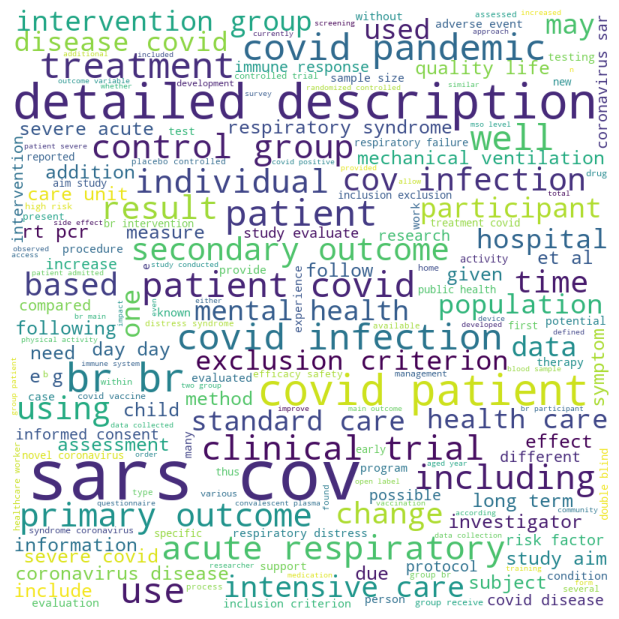

In [42]:
# Form a word cloud out of processed text
from wordcloud import WordCloud, STOPWORDS
from textwrap import wrap
import matplotlib.pyplot as plt
%matplotlib inline
from pandas.core.common import flatten

total_text = flatten(df.Abstract)
text = ''.join(total_text)
stopwords = set(STOPWORDS)
wordcloud = WordCloud(width=800, height=800, background_color='white',stopwords=stopwords, min_font_size=10).generate(text)

# plot the word cloud image
plt.figure(figsize=(12,6))
plt.imshow(wordcloud)
plt.axis('off')
plt.tight_layout(pad=0)

plt.show()


In [69]:
x=[word_tokenize(word) for word in df.Abstract ]


In [68]:
df.Abstract[0]

'week prospective randomized controlled intradermal administration comirnaty microgram compare intramuscular comirnaty microgram day interval efficacy study group healthy volunteer people complete sinovac vaccination people received dosage astrazeneca vaccine naive vaccination vaccination anti spike antibody le au ml comparison antibody level cell response sar cov antigen vitro day post vaccination primary outcome side effect well infection rate week secondary outcome detailed description week prospective randomized controlled intradermal administration comirnaty microgram compare intramuscular comirnaty microgram day interval efficacy study healthy volunteer compare antispike antibody anti rbd neutralized antibody possible sar cov cell response injection intradermal comirnaty microgram versus intramuscular comirnaty microgram day interval healthy volunteer various immunological background group patient vaccinated without history previous covid infection various immunological backgroun

In [71]:
# Training Skipgram model with vector size of 50
skipgram_50 = Word2Vec(x, vector_size=50,window=3,min_count=2,sg=1)

In [72]:
# Training skipgram model with vector size of 100
skipgram_100 = Word2Vec(x, vector_size=100,window=3,min_count=2,sg=1)

In [73]:
# Training fasttext model with vector size of 200
fast_n_200 = FastText(x,vector_size=200, window=3, min_count=2, workers=5, min_n=1,max_n=2, sg=1)

In [74]:
# Training fasttext model with vector size of 100
fast_n_100 = FastText(x,vector_size=100, window=3, min_count=2, workers=5, min_n=1,max_n=2, sg=1)

In [75]:
# Save those trained models
skipgram_50.save("skipgram_50.bin")
skipgram_100.save("skipgram_100.bin")
fast_n_100.save("fast_n_100.bin")
fast_n_200.save("fast_n_200.bin")

In [77]:
df.to_csv('processed_text.csv')